# Template Matching

We first load the original and template images, and convert them to greyscale.

In [ ]:
# the original image
original_image = cv2.imread('snow.jpg')
original_grayscale = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)

# the template image
template_image = cv2.imread('snowtemp.jpg')
template_grayscale = cv2.cvtColor(template_image, cv2.COLOR_BGR2GRAY)

Next, we implement a function to compute cross-correlation between the image and the template as below.

This function computes a correlation score for every possible position of the template in the image. We also normalize the scores in case of varying brightness and contrast.

In [ ]:
def cross_correlation(image, template):

    # We get the dimensions of both the template and the original image to iterate over
    template_height, template_width = template.shape
    image_height, image_width = image.shape

    # the output array
    cc = np.zeros((image_height - template_height + 1, image_width - template_width + 1))

    # mean and std of the template
    template_mean, template_std = np.mean(template), np.std(template)

    # Iterate over every position
    for y in range(cc.shape[0]):
        for x in range(cc.shape[1]):

            # mean and std of the region of interest
            roi = image[y:y + template_height, x:x + template_width]
            roi_mean, roi_std = np.mean(roi), np.std(roi)

            # the normalized cross-correlation
            if roi_std > 0 and template_std > 0:
                # cross-correlation
                cc[y, x] = np.sum((roi - roi_mean) * (template - template_mean)) / (roi_std * template_std)
            else:
                # cases where std is zero
                cc[y, x] = 0

    return cc

We call the function to find the correlation map.

In [ ]:
cc_map = cross_correlation(original_grayscale, template_grayscale)

Next, we parse the correlation image to detect the maximum peak value and its (x,y) location as below:

Max Peak Location: (x, y) = (1447, 762)


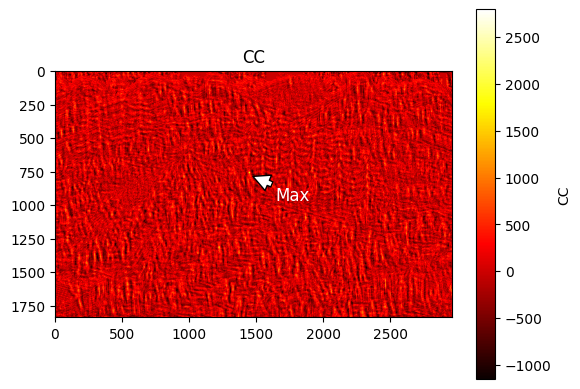

In [ ]:
max_val = np.max(cc_map)
max_loc = np.unravel_index(np.argmax(cc_map), cc_map.shape)

# coordinates of the highest peak
print(f"Max Peak Location: (x, y) = {max_loc[1], max_loc[0]}")

# plot of the correlation output
plt.imshow(cc_map, cmap='hot', interpolation='nearest')
plt.colorbar(label='CC')

    # Annotate the maximum peak location
plt.annotate('Max', xy=(max_loc[1]+20, max_loc[0]+20), xytext=(max_loc[1] + 200, max_loc[0] + 200),
                 arrowprops=dict(facecolor='white', shrink=0.05), fontsize=12, color='white')

plt.title('CC')
plt.show()

We can see that this location is close to where the object is located in the original image, so it matches our expectations.

Finally, we mark the detected location on the original image with a black rectangle. The results are as below:

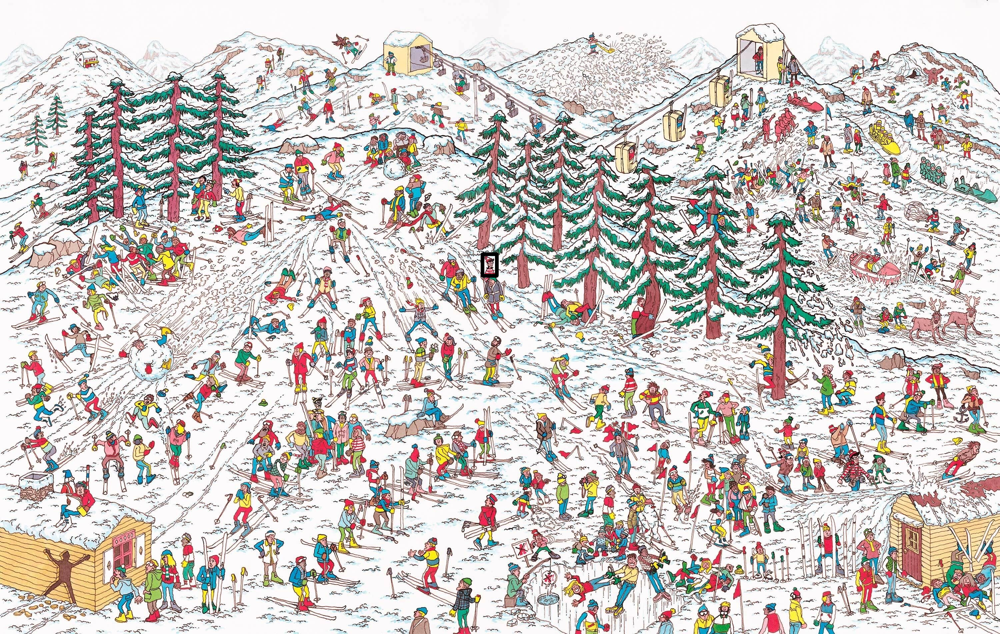

In [ ]:
# location with max correlation
y_loc, x_loc = np.unravel_index(np.argmax(cc_map), cc_map.shape)

template_height, template_width = template_grayscale.shape
cv2.rectangle(original_image, (x_loc, y_loc), (x_loc + template_width, y_loc + template_height), (0, 0, 0), 10)
cv2_imshow(original_image)

# Creative Section

First, we check the timing of the approach implemented in the previous part:

In [ ]:
# the original image
original_image = cv2.imread('WaldoBeach.jpg')
original_grayscale = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)

# the template image
template_image = cv2.imread('WaldoBeachtemp.jpg')
template_grayscale = cv2.cvtColor(template_image, cv2.COLOR_BGR2GRAY)

# Start
t_start = time.time()

cc_map = cross_correlation(original_grayscale, template_grayscale)

# End
t_end = time.time()

print(f"Time = {t_end - t_start} secs")

Time = 43.638957023620605 secs


We check the function to see if it has found Waldo correectly:

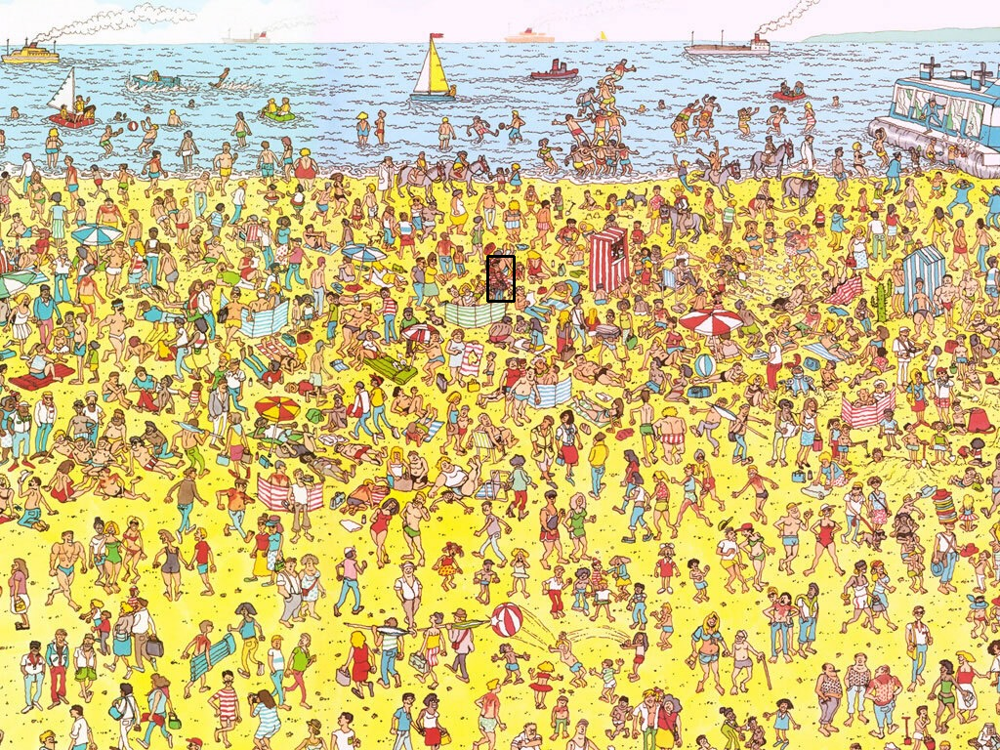

In [ ]:
# location with max correlation
y_loc, x_loc = np.unravel_index(np.argmax(cc_map), cc_map.shape)

template_height, template_width = template_grayscale.shape
cv2.rectangle(original_image, (x_loc, y_loc), (x_loc + template_width, y_loc + template_height), (0, 0, 0), 2)
cv2_imshow(original_image)

Next, we try to improve the algorithm:

In this case, we use integral image by using cumulative sums for faster calculation of the sum over any rectangular region in constant time O(1).

However, the original approach computes the sum and mean of each region of interest (ROI) by iterating through the pixels, which is O(n⋅m) for each ROI.

Implementing this should reduce the computation time, especially for larger images and templates, because this approach minimizes the overall number of iterations needed and reduces the number of operations per pixel

In [ ]:
def fast_cross_correlation(image, template):

    # Convert image to np.int32 to prevent overflow
    image = image.astype(np.int32)

    # dimensions of both the template and the original image
    template_height, template_width = template.shape
    image_height, image_width = image.shape

    # output for cc
    cc = np.zeros((image_height - template_height + 1, image_width - template_width + 1))

    # mean and std of the template
    template_mean = np.mean(template)
    template_std = np.std(template)

    # cumulative sums for faster ROI extraction
    integral_image = np.cumsum(np.cumsum(image, axis=0), axis=1)

    # sum over a rectangular window using the integral image
    def window_sum(integral_img, x1, y1, x2, y2):
        return (integral_img[y2, x2]
                - (integral_img[y1 - 1, x2] if y1 > 0 else 0)
                - (integral_img[y2, x1 - 1] if x1 > 0 else 0)
                + (integral_img[y1 - 1, x1 - 1] if y1 > 0 and x1 > 0 else 0))

    for y in range(cc.shape[0]):
        for x in range(cc.shape[1]):
            # Extract the sum for the region of interest using the cumulative sum
            roi_sum = window_sum(integral_image, x, y, x + template_width - 1, y + template_height - 1)
            roi_area = template_height * template_width
            roi_mean = roi_sum / roi_area

            # ROI and its standard deviation
            roi = image[y:y + template_height, x:x + template_width]
            roi_std = np.std(roi)

            # cross-correlation
            if roi_std > 0 and template_std > 0:
                cc[y, x] = np.sum((roi - roi_mean) * (template - template_mean)) / (roi_std * template_std)
            else:
                cc[y, x] = 0

    return cc

We check the timing of the new approach:

In [ ]:
# Start
t_start = time.time()

cc_map = fast_cross_correlation(original_grayscale, template_grayscale)

# End
t_end = time.time()

print(f"Time = {t_end - t_start} secs")

Time = 37.93748426437378 secs


We check the function to see if it has found Waldo correectly:

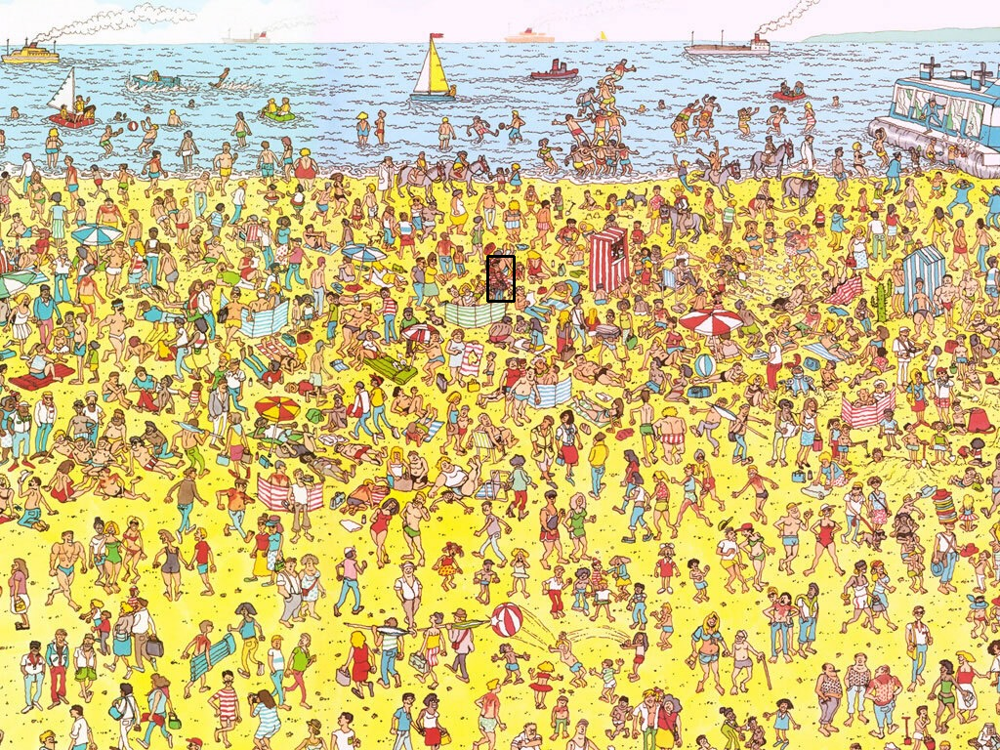

In [ ]:
# location with max correlation
y_loc, x_loc = np.unravel_index(np.argmax(cc_map), cc_map.shape)

template_height, template_width = template_grayscale.shape
cv2.rectangle(original_image, (x_loc, y_loc), (x_loc + template_width, y_loc + template_height), (0, 0, 0), 2)
cv2_imshow(original_image)

As we can see, both approaches are able to find Waldo, but the second approach does this in 5.7 secoonds (about 13% times) faster.

We put everything for the new faster approach in the function below, which will output the final image with the bounding box.

In [ ]:
def fast_cross_correlation(original_image, original_template):

    # the original image
    image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)

    # the template image
    template = cv2.cvtColor(original_template, cv2.COLOR_BGR2GRAY)

    # Convert image to np.int32 to prevent overflow
    image = image.astype(np.int32)

    # dimensions of both the template and the original image
    template_height, template_width = template.shape
    image_height, image_width = image.shape

    # output for cc
    cc = np.zeros((image_height - template_height + 1, image_width - template_width + 1))

    # mean and std of the template
    template_mean = np.mean(template)
    template_std = np.std(template)

    # cumulative sums for faster ROI extraction
    integral_image = np.cumsum(np.cumsum(image, axis=0), axis=1)

    # calculate the sum over a rectangular window using the integral image
    def window_sum(integral_img, x1, y1, x2, y2):
        return (integral_img[y2, x2]
                - (integral_img[y1 - 1, x2] if y1 > 0 else 0)
                - (integral_img[y2, x1 - 1] if x1 > 0 else 0)
                + (integral_img[y1 - 1, x1 - 1] if y1 > 0 and x1 > 0 else 0))

    for y in range(cc.shape[0]):
        for x in range(cc.shape[1]):
            # Extract the sum for the region of interest using the cumulative sum
            roi_sum = window_sum(integral_image, x, y, x + template_width - 1, y + template_height - 1)
            roi_area = template_height * template_width
            roi_mean = roi_sum / roi_area

            # Extract the ROI and calculate its standard deviation
            roi = image[y:y + template_height, x:x + template_width]
            roi_std = np.std(roi)

            # Perform normalized cross-correlation
            if roi_std > 0 and template_std > 0:
                cc[y, x] = np.sum((roi - roi_mean) * (template - template_mean)) / (roi_std * template_std)
            else:
                cc[y, x] = 0



    # location with max correlation
    y_loc, x_loc = np.unravel_index(np.argmax(cc), cc.shape)

    # template dimensions
    template_height, template_width = template.shape

    # draw rectangle around the detected template
    cv2.rectangle(original_image, (x_loc, y_loc), (x_loc + template_width, y_loc + template_height), (0, 0, 0), 2)

    # original image with the detected template
    cv2_imshow(original_image)

You can call the function as below, after defining your original and template images.

In [ ]:
original_image = cv2.imread('WaldoBeach.jpg')
template_image = cv2.imread('WaldoBeachtemp.jpg')

# calling the function
fast_cross_correlation(original_image, template_image)